In [149]:
#%reset -f
import os
from pandas import Series
import pandasql
from sklearn.metrics import mean_squared_error
# from statsmodels.tsa.arima_model import ARIMA
# from statsmodels.tsa.arima_model import ARIMAResults
# from statsmodels.tsa.statespace.sarimax import SARIMAX
from math import sqrt
from pandas import DataFrame
# from scipy.stats import boxcox
import pandas as pd  # data frame operations
import numpy as np  # arrays and math functions
from sklearn import linear_model
# from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from scipy.stats import uniform  # for training-and-test split
import statsmodels.api as sm  # statistical models (including regression)
import statsmodels.formula.api as smf  # R-like model specification
import matplotlib.pyplot as plt  # 2D plotting
import seaborn as sns  # PROVIDES TRELLIS AND SMALL MULTIPLE PLOTTING
sns.set(color_codes=True)
from pandas import read_csv
import matplotlib as mpl
from matplotlib import pyplot
# from sklearn.preprocessing import MinMaxScaler
# from sklearn.preprocessing import LabelEncoder
# from sklearn.metrics import mean_squared_error
#from keras.models import Sequential
#from keras.layers import Dense
#from keras.layers import LSTM
import matplotlib.pyplot as plt
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True) 
import plotly.graph_objs as go
import plotly.offline as py
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import plot_roc_curve
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import classification_report



In [150]:
# This funtion takes the file and checks & processes
def LoadFile(dataFileName):
    isExisted = os.path.isfile(dataFileName)
    if isExisted == True: # Read in the data when the file does exist
        df = pd.read_csv(dataFileName, encoding = 'latin-1')
    else: # Print our message when the file provide does not exist
        print("File name:", dataFileName, "does not exist in", os.getcwd(), "folder")
    return pd.DataFrame(df)

In [151]:
# Load files by using LoadFile function defines above
states_by_county_death = LoadFile("data/COVID-19_Death_Counts_in_the_United_States_by_County.csv")
state = LoadFile("data/State.csv")
us_counties_cases_deathss = LoadFile("data/us_counties.csv")
us_counties_cases_deaths = LoadFile("data/us_counties_cases_deaths.csv")
detail_2018_county_health_rankings = LoadFile("data/detail_2018_county_health_rankings.csv")
overall_2018_county_health_ranking = LoadFile("data/overall_2018_county_health_ranking.csv")
MetropolitanPopulation = LoadFile("data/Population_Density_By_County.csv")

In [152]:
us_counties_cases_deaths.columns[us_counties_cases_deaths.isna().any()].tolist()

['fips']

In [153]:
overall_2018_county_health_ranking.columns[overall_2018_county_health_ranking.isna().any()].tolist()

[]

In [154]:
detail_2018_county_health_rankings.columns[detail_2018_county_health_rankings.isna().any()].tolist()

['Number_Adult_Deaths',
 'Age_Adjusted_Mortality',
 'Age_Adjusted_Mortality_Black',
 'Age_Adjusted_Mortality_Hispanic',
 'Age_Adjusted_Mortality_White',
 'Number_Child_Deaths',
 'Child_Mortality_Rate',
 'Child_Mortality_Rate_Black',
 'Child_Mortality_Rate_Hispanic',
 'Child_Mortality_Rate_White',
 'Number_Infant_Deaths',
 'Infant Mortality Rate',
 'Infant_Mortality_Rate_Black',
 'Infant_Mortality_Rate_Hispanic',
 'Infant_Mortality_Rate_White',
 'HIV_Prevalence_Rate',
 'Percent_Limited_Access',
 'Drug_Overdose_Mortality_Rate',
 'Range Drug Overdose Mortality Rate',
 'Motor_Vehicle_Mortality_Rate',
 'Percent_Uninsured_Adults',
 'Percent_Uninsured_Children',
 'Heath_Care_Costs',
 'PCP_Rate',
 'PCP_Ratio',
 'Percent_Disconnected_Youth',
 'Household_Income',
 'Household_ income_Black',
 'Household_ income_Hispanic',
 'Household_ income_White',
 'Percent_Free_Reduced_Lunch',
 'Segregation_Index_Black_White',
 'Segregation_Index_Nonwhite_White',
 'Homicide_Rate',
 'Firearm_Fatalities_Rate',
 

In [155]:
detail_2018_county_health_rankings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3142 entries, 0 to 3141
Data columns (total 56 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   FIPS                                3142 non-null   int64  
 1   State                               3142 non-null   object 
 2   County                              3142 non-null   object 
 3   Number_Adult_Deaths                 3077 non-null   float64
 4   Age_Adjusted_Mortality              3077 non-null   float64
 5   Age_Adjusted_Mortality_Black        1334 non-null   float64
 6   Age_Adjusted_Mortality_Hispanic     797 non-null    float64
 7   Age_Adjusted_Mortality_White        1556 non-null   float64
 8   Number_Child_Deaths                 1931 non-null   float64
 9   Child_Mortality_Rate                1931 non-null   float64
 10  Child_Mortality_Rate_Black          498 non-null    float64
 11  Child_Mortality_Rate_Hispanic       359 non

In [156]:
detail_2018_county_health_rankings = detail_2018_county_health_rankings.drop(columns=['PCP_Ratio'], axis = 1)
detail_2018_county_health_rankings = detail_2018_county_health_rankings.drop(columns=['Unnamed: 55'], axis = 1)

In [157]:
detail_2018_county_health_rankings = detail_2018_county_health_rankings.sort_values(by=['State', 'County'])
for column in detail_2018_county_health_rankings.columns[3:]:
    averageValue = detail_2018_county_health_rankings.groupby(['State','County'])[column].transform('median')
    detail_2018_county_health_rankings[column].fillna(averageValue , inplace=True)

In [158]:
detail_2018_county_health_rankings = detail_2018_county_health_rankings.ffill().bfill()

In [159]:
detail_2018_county_health_rankings.head()

,FIPS,State,County,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,...,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,1001,Alabama,Autauga,827.0,450.0,532.0,111.0,445.0,31.0,56.2,...,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,1003,Alabama,Baldwin,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,...,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,1005,Alabama,Barbour,418.0,434.0,477.0,111.0,395.0,15.0,66.6,...,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,1007,Alabama,Bibb,408.0,529.0,630.0,111.0,527.0,22.0,116.3,...,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,1009,Alabama,Blount,996.0,480.0,630.0,111.0,527.0,30.0,55.4,...,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


In [160]:
states_by_county_death.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 461 entries, 0 to 460
Data columns (total 8 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   Date as of                 461 non-null    object
 1   First week                 461 non-null    object
 2   Last week                  461 non-null    object
 3   State                      461 non-null    object
 4   County name                461 non-null    object
 5   FIPS County Code           461 non-null    int64 
 6   Deaths involving COVID-19  461 non-null    int64 
 7   Deaths from All Causes     461 non-null    int64 
dtypes: int64(3), object(5)
memory usage: 28.9+ KB


In [161]:
for column in states_by_county_death.columns:
    states_by_county_death.rename(columns={column: column.replace(' ', '_')}, inplace=True)
states_by_county_death.rename(columns={'County_name': 'County_Name'}, inplace=True)

In [162]:
states_by_county_death['County_Name'] = states_by_county_death['County_Name'].str.replace(' County', '')

In [163]:
MetropolitanPopulation['County_Name'] = MetropolitanPopulation['County_Name'].str.replace(' County', '')

In [164]:
states_by_county_death.head()

,Date_as_of,First_week,Last_week,State,County_Name,FIPS_County_Code,Deaths_involving_COVID-19,Deaths_from_All_Causes
0,5/20/2020,2/1/2020,5/16/2020,AL,Etowah,1055,11,432
1,5/20/2020,2/1/2020,5/16/2020,AL,Houston,1069,24,542
2,5/20/2020,2/1/2020,5/16/2020,AL,Jefferson,1073,79,2675
3,5/20/2020,2/1/2020,5/16/2020,AL,Lee,1081,43,362
4,5/20/2020,2/1/2020,5/16/2020,AL,Madison,1089,10,1149


In [165]:
states_by_county_death['FIPS_County_Code'] = states_by_county_death['FIPS_County_Code'].astype(str)
states_by_county_death['FIPS_County_Code'] = states_by_county_death['FIPS_County_Code'].str.pad(width=5, side='left', fillchar='0')

In [166]:
states_by_county_death_agg = pandasql.sqldf("SELECT sc.State State, sc.County_Name, sc.FIPS_County_Code [FIPS_Code], sc.[Deaths_involving_COVID-19] [COVID_Death], sc.Deaths_from_All_Causes [All_Cause_Death] FROM states_by_county_death sc")

In [167]:
states_by_county_death.head()

,Date_as_of,First_week,Last_week,State,County_Name,FIPS_County_Code,Deaths_involving_COVID-19,Deaths_from_All_Causes
0,5/20/2020,2/1/2020,5/16/2020,AL,Etowah,01055,11,432
1,5/20/2020,2/1/2020,5/16/2020,AL,Houston,01069,24,542
2,5/20/2020,2/1/2020,5/16/2020,AL,Jefferson,01073,79,2675
3,5/20/2020,2/1/2020,5/16/2020,AL,Lee,01081,43,362
4,5/20/2020,2/1/2020,5/16/2020,AL,Madison,01089,10,1149


In [168]:
states_by_county_death_agg = pandasql.sqldf("SELECT sc.*, s.StateName State_Name FROM states_by_county_death_agg sc LEFT JOIN state s ON rtrim(sc.State) = rtrim(ltrim(s.State))")

In [169]:
states_by_county_death[states_by_county_death['County_Name'] == 'Nassau']

,Date_as_of,First_week,Last_week,State,County_Name,FIPS_County_Code,Deaths_involving_COVID-19,Deaths_from_All_Causes
302,5/20/2020,2/1/2020,5/16/2020,NY,Nassau,36059,2430,6804


In [170]:
states_by_county_death_agg.head()

,State,County_Name,FIPS_Code,COVID_Death,All_Cause_Death,State_Name
0,AL,Etowah,01055,11,432,Alabama
1,AL,Houston,01069,24,542,Alabama
2,AL,Jefferson,01073,79,2675,Alabama
3,AL,Lee,01081,43,362,Alabama
4,AL,Madison,01089,10,1149,Alabama


In [171]:
us_counties_cases_deaths.rename(columns={'fips': 'FIPS_Code'}, inplace=True)
us_counties_cases_deaths.rename(columns={'state': 'State_Name'}, inplace=True)
us_counties_cases_deaths.rename(columns={'county': 'County_Name'}, inplace=True)
us_counties_cases_deaths.rename(columns={'date': 'Date_Name'}, inplace=True)

In [172]:
us_counties_cases_deaths.head()

,Date_Name,County_Name,State_Name,FIPS_Code,cases,deaths
0,2020-01-21,Snohomish,Washington,53061.0,1,0
1,2020-01-22,Snohomish,Washington,53061.0,1,0
2,2020-01-23,Snohomish,Washington,53061.0,1,0
3,2020-01-24,Cook,Illinois,17031.0,1,0
4,2020-01-24,Snohomish,Washington,53061.0,1,0


In [173]:
us_counties_cases_deaths['FIPS_Code'] = us_counties_cases_deaths['FIPS_Code'].astype(str)
us_counties_cases_deaths['FIPS_Code'] = us_counties_cases_deaths['FIPS_Code'].str.replace('.0', '')
us_counties_cases_deaths['FIPS_Code'] =  us_counties_cases_deaths['FIPS_Code'].str.pad(width=5, side='left', fillchar='0')

In [174]:
us_counties_cases_deaths.head()

,Date_Name,County_Name,State_Name,FIPS_Code,cases,deaths
0,2020-01-21,Snohomish,Washington,00561,1,0
1,2020-01-22,Snohomish,Washington,00561,1,0
2,2020-01-23,Snohomish,Washington,00561,1,0
3,2020-01-24,Cook,Illinois,00131,1,0
4,2020-01-24,Snohomish,Washington,00561,1,0


In [175]:
overall_2018_county_health_ranking.rename(columns={'ï»¿FIPS': 'FIPS_Code'}, inplace=True)
overall_2018_county_health_ranking.rename(columns={'ï»¿FIPS': 'FIPS_Code'}, inplace=True)

In [176]:
us_counties_cases_deaths_agg = pandasql.sqldf("SELECT s.State, c.State_Name, c.County_Name, c.FIPS_Code, SUM(c.cases) COVID_Confirm, SUM(c.deaths) COVID_Death FROM us_counties_cases_deaths c LEFT JOIN state s ON c.State_Name = s.StateName GROUP BY c.State_Name, c.County_Name, c.FIPS_Code")

In [177]:
us_counties_cases_deaths_agg.head()

,State,State_Name,County_Name,FIPS_Code,COVID_Confirm,COVID_Death
0,AL,Alabama,Autauga,00001,2717,123
1,AL,Alabama,Baldwin,00003,7949,197
2,AL,Alabama,Barbour,00005,1981,24
3,AL,Alabama,Bibb,00007,1689,15
4,AL,Alabama,Blount,00009,1590,6


In [178]:
us_counties_cases_deaths.tail()

,Date_Name,County_Name,State_Name,FIPS_Code,cases,deaths
167834,2020-05-22,Sublette,Wyoming,00535,3,0
167835,2020-05-22,Sweetwater,Wyoming,00537,25,0
167836,2020-05-22,Teton,Wyoming,00539,100,1
167837,2020-05-22,Uinta,Wyoming,00541,13,0
167838,2020-05-22,Washakie,Wyoming,00543,19,1


In [179]:
us_counties_cases_deaths.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 167839 entries, 0 to 167838
Data columns (total 6 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   Date_Name    167839 non-null  object
 1   County_Name  167839 non-null  object
 2   State_Name   167839 non-null  object
 3   FIPS_Code    167839 non-null  object
 4   cases        167839 non-null  int64 
 5   deaths       167839 non-null  int64 
dtypes: int64(2), object(4)
memory usage: 7.7+ MB


In [180]:
COVID_19_522 = pandasql.sqldf("SELECT s.State, c.State_Name, c.County_Name, c.FIPS_Code, c.cases COVID_Confirm, c.deaths COVID_Death FROM us_counties_cases_deaths c JOIN state s ON c.State_Name = s.StateName WHERE Date_Name = '2020-05-22' AND c.County_Name <> 'Unknown'")

In [181]:
COVID_19_522.head()

,State,State_Name,County_Name,FIPS_Code,COVID_Confirm,COVID_Death
0,AL,Alabama,Autauga,00001,149,3
1,AL,Alabama,Baldwin,00003,271,9
2,AL,Alabama,Barbour,00005,104,1
3,AL,Alabama,Bibb,00007,55,1
4,AL,Alabama,Blount,00009,49,1


In [182]:
#pandasql.sqldf("SELECT DISTINCT State, State_Name FROM COVID_19")

In [183]:
us_counties_cases_deaths.rename(columns={'date': 'Date_Name'}, inplace=True)

In [184]:
us_counties_cases_deaths.head()

,Date_Name,County_Name,State_Name,FIPS_Code,cases,deaths
0,2020-01-21,Snohomish,Washington,00561,1,0
1,2020-01-22,Snohomish,Washington,00561,1,0
2,2020-01-23,Snohomish,Washington,00561,1,0
3,2020-01-24,Cook,Illinois,00131,1,0
4,2020-01-24,Snohomish,Washington,00561,1,0


In [185]:
COVID_19_BY_STATE = pandasql.sqldf("SELECT State, SUM(COVID_Confirm) COVID_Confirm, SUM(COVID_Death) COVID_Death FROM COVID_19_522 GROUP BY State")

In [186]:
COVID_19_BY_STATE.head()

,State,COVID_Confirm,COVID_Death
0,AK,403,8
1,AL,13670,541
2,AR,5468,113
3,AZ,15608,775
4,CA,90801,3690


In [187]:
data = dict (
    type = 'choropleth',
    locations = COVID_19_BY_STATE['State'],
    locationmode='USA-states',
    colorscale = ['#3f39bd', '#4ae5f0','#4bd673','#c2c43d'],
    colorbar_title = 'Total',
    #text = COVID_19_BY_STATE['FIPS_Code'],
     showlegend = True,
    z=COVID_19_BY_STATE['COVID_Confirm'])
    
layout = dict(
        title = 'Confirmed Cases',
        geo = dict(scope='usa'))

map = go.Figure(data=[data], layout = layout)
py.iplot(map)

In [188]:
data = dict (
    type = 'choropleth',
    locations = COVID_19_BY_STATE['State'],
    locationmode='USA-states',
    colorscale = 'REDS',
    colorbar_title = 'Total',
     showlegend = True,
    z=COVID_19_BY_STATE['COVID_Death'])
    
layout = dict(
        title = 'Confirmed COVID Death',
        geo = dict(scope='usa'))

map = go.Figure(data=[data], layout = layout)
py.iplot(map)

In [189]:
data = dict (
    type = 'choropleth',
    locations = states_by_county_death['State'],
    locationmode='USA-states',
    colorscale = ['#3f39bd', '#4ae5f0','#4bd673','#c2c43d'],
    colorbar_title = 'Total',
     #text = COVID_19['FIPS_Code'],
     showlegend = True,
     z=states_by_county_death['Deaths_from_All_Causes'])
    
layout = dict(
        title = 'All Cause of Death',
        geo = dict(scope='usa'))

map = go.Figure(data=[data], layout = layout)
py.iplot(map)

In [190]:
#overall_2018_county_health_ranking['FIPS_Code'] = overall_2018_county_health_ranking['FIPS_Code'].astype(str)
#overall_2018_county_health_ranking['FIPS_Code'] = overall_2018_county_health_ranking['FIPS_Code'].str.pad(width=5, side='left', fillchar='0')

In [191]:
overall_2018_county_health_ranking.head()

,FIPS_Code,State,County,Length of Life Rank,Quality of Life Rank,Health Behaviors Rank,Clinical Care Rank,Social & Economic Factors Rank,Physical Environment Rank,Health Outcomes Rank,Health Factors Rank
0,1001,Alabama,Autauga,18,5,12,15,3,51,11,8
1,1003,Alabama,Baldwin,4,4,3,7,8,14,3,3
2,1005,Alabama,Barbour,14,49,57,20,58,16,34,56
3,1007,Alabama,Bibb,53,25,39,42,42,29,41,37
4,1009,Alabama,Blount,17,12,11,41,13,54,14,19


In [192]:
#detail_2018_county_health_rankings.rename(columns={'FIPS': 'FIPS_Code'}, inplace=True)
detail_2018_county_health_rankings.rename(columns={'State': 'State_Name'}, inplace=True)

In [193]:
#detail_2018_county_health_rankings.info()

In [194]:
detail_2018_county_health_rankings.head()

,FIPS,State_Name,County,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,...,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,1001,Alabama,Autauga,827.0,450.0,532.0,111.0,445.0,31.0,56.2,...,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,1003,Alabama,Baldwin,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,...,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,1005,Alabama,Barbour,418.0,434.0,477.0,111.0,395.0,15.0,66.6,...,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,1007,Alabama,Bibb,408.0,529.0,630.0,111.0,527.0,22.0,116.3,...,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,1009,Alabama,Blount,996.0,480.0,630.0,111.0,527.0,30.0,55.4,...,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


In [195]:
for column in overall_2018_county_health_ranking.columns:
    overall_2018_county_health_ranking.rename(columns={column: column.replace(' ', '_').replace('&_', '')}, inplace=True)
    
overall_2018_county_health_ranking.rename(columns={'State': 'State_Name'}, inplace=True)
overall_2018_county_health_ranking.rename(columns={'County': 'County_Name'}, inplace=True)

In [196]:
#overall_2018_county_health_ranking.info()

In [197]:
overall_2018_county_health_ranking.tail()

,FIPS_Code,State_Name,County_Name,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank
3137,56037,Wyoming,Sweetwater,6,18,20,11,20,19,15,21
3138,56039,Wyoming,Teton,1,2,1,1,1,15,1,1
3139,56041,Wyoming,Uinta,18,21,19,6,17,13,21,17
3140,56043,Wyoming,Washakie,5,14,7,22,16,5,8,15
3141,56045,Wyoming,Weston,10,3,17,12,11,9,4,14


In [198]:
COVID_19_522.tail()

,State,State_Name,County_Name,FIPS_Code,COVID_Confirm,COVID_Death
2927,WY,Wyoming,Sublette,00535,3,0
2928,WY,Wyoming,Sweetwater,00537,25,0
2929,WY,Wyoming,Teton,00539,100,1
2930,WY,Wyoming,Uinta,00541,13,0
2931,WY,Wyoming,Washakie,00543,19,1


In [199]:
COVID_19_522_OVERALL_HEALTH = pandasql.sqldf("SELECT c.State, c.State_Name, c.County_Name, c.COVID_Confirm, c.COVID_Death, o.Length_of_Life_Rank, o.Quality_of_Life_Rank, o.Health_Behaviors_Rank, o.Clinical_Care_Rank, o.Social_Economic_Factors_Rank, o.Physical_Environment_Rank, o.Health_Outcomes_Rank, o.Health_Factors_Rank FROM COVID_19_522 c LEFT JOIN overall_2018_county_health_ranking o ON c.State_Name = o.State_Name AND c.County_Name = o.County_Name")

In [200]:
COVID_19_522_OVERALL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank
0,AL,Alabama,Autauga,149,3,18,5,12,15,3,51,11,8
1,AL,Alabama,Baldwin,271,9,4,4,3,7,8,14,3,3
2,AL,Alabama,Barbour,104,1,14,49,57,20,58,16,34,56
3,AL,Alabama,Bibb,55,1,53,25,39,42,42,29,41,37
4,AL,Alabama,Blount,49,1,17,12,11,41,13,54,14,19


In [201]:
COVID_19_522_DETAIL_HEALTH = pandasql.sqldf("SELECT c.State, c.State_Name, c.County_Name, c.COVID_Confirm, c.COVID_Death, o.[Number_Adult_Deaths], o.[Age_Adjusted_Mortality],o.[Age_Adjusted_Mortality_Black],o.[Age_Adjusted_Mortality_Hispanic],o.[Age_Adjusted_Mortality_White],o.[Number_Child_Deaths], o.[Child_Mortality_Rate],o.[Child_Mortality_Rate_Black],o.[Child_Mortality_Rate_Hispanic], o.[Child_Mortality_Rate_White],o.[Number_Infant_Deaths],o.[Infant Mortality Rate],o.[Infant_Mortality_Rate_Black],o.[Infant_Mortality_Rate_Hispanic],o.[Infant_Mortality_Rate_White],o.[Percent_Frequent_Physical_Distress],o.[Percent_Frequent_Mental_Distress],o.[Percent_Diabetic],o.[HIV_Prevalence_Rate],o.[Percent_Food_Insecure],o.[Percent_Limited_Access],o.[Drug_Overdose_Mortality_Rate],o.[Range Drug Overdose Mortality Rate],o.[Motor_Vehicle_Mortality_Rate],o.[Percent_Insufficient_ Sleep],o.[Percent_Uninsured_Adults],o.[Percent_Uninsured_Children],o.[Heath_Care_Costs],o.[PCP_Rate], o.[Percent_Disconnected_Youth],o.[Household_Income],o.[Household_ income_Black],o.[Household_ income_Hispanic],o.[Household_ income_White],o.[Percent_Free_Reduced_Lunch],o.[Segregation_Index_Black_White],o.[Segregation_Index_Nonwhite_White],o.[Homicide_Rate],o.[Firearm_Fatalities_Rate],o.[Population],o.[Percent_Under18],o.[Percent_65_and_over],o.[Percent_African_American],o.[Percent_American_Alaskan_Indian],o.[Percent_Asian],o.[Percent_Hawaiian_PacificIslander],o.[Percent_Hispanic],o.[Percent_White],o.[Percent_ Not_Proficient_English],o.[Percent_Female],o.[Percent_Rural] FROM COVID_19_522 c LEFT JOIN detail_2018_county_health_rankings o ON c.State_Name = o.State_Name AND c.County_Name = o.County")

In [202]:
COVID_19_522.head()

,State,State_Name,County_Name,FIPS_Code,COVID_Confirm,COVID_Death
0,AL,Alabama,Autauga,00001,149,3
1,AL,Alabama,Baldwin,00003,271,9
2,AL,Alabama,Barbour,00005,104,1
3,AL,Alabama,Bibb,00007,55,1
4,AL,Alabama,Blount,00009,49,1


In [203]:
detail_2018_county_health_rankings.head()

,FIPS,State_Name,County,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,...,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,1001,Alabama,Autauga,827.0,450.0,532.0,111.0,445.0,31.0,56.2,...,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,1003,Alabama,Baldwin,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,...,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,1005,Alabama,Barbour,418.0,434.0,477.0,111.0,395.0,15.0,66.6,...,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,1007,Alabama,Bibb,408.0,529.0,630.0,111.0,527.0,22.0,116.3,...,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,1009,Alabama,Blount,996.0,480.0,630.0,111.0,527.0,30.0,55.4,...,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


In [204]:
COVID_19_522_DETAIL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,...,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,AL,Alabama,Autauga,149,3,827.0,450.0,532.0,111.0,445.0,...,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,...,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,...,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,AL,Alabama,Bibb,55,1,408.0,529.0,630.0,111.0,527.0,...,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,AL,Alabama,Blount,49,1,996.0,480.0,630.0,111.0,527.0,...,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


In [205]:
#COVID_19_522_DETAIL_HEALTH = COVID_19_522_DETAIL_HEALTH.dropna(inplace=True)

In [206]:
COVID_19_522_DETAIL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,...,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,AL,Alabama,Autauga,149,3,827.0,450.0,532.0,111.0,445.0,...,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,...,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,...,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,AL,Alabama,Bibb,55,1,408.0,529.0,630.0,111.0,527.0,...,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,AL,Alabama,Blount,49,1,996.0,480.0,630.0,111.0,527.0,...,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


In [207]:
for column in COVID_19_522_OVERALL_HEALTH.columns:
    COVID_19_522_OVERALL_HEALTH[column] = COVID_19_522_OVERALL_HEALTH[column].astype(str).replace('NR', '0')
    COVID_19_522_OVERALL_HEALTH[column] = COVID_19_522_OVERALL_HEALTH[column].astype(str).replace('None', '0')

In [208]:
for column in COVID_19_522_OVERALL_HEALTH.columns[3:13]:
    COVID_19_522_OVERALL_HEALTH[column] = pd.to_numeric(COVID_19_522_OVERALL_HEALTH[column])

In [209]:
COVID_19_522_OVERALL_HEALTH.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2932 entries, 0 to 2931
Data columns (total 13 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   State                         2932 non-null   object
 1   State_Name                    2932 non-null   object
 2   County_Name                   2932 non-null   object
 3   COVID_Confirm                 2932 non-null   int64 
 4   COVID_Death                   2932 non-null   int64 
 5   Length_of_Life_Rank           2932 non-null   int64 
 6   Quality_of_Life_Rank          2932 non-null   int64 
 7   Health_Behaviors_Rank         2932 non-null   int64 
 8   Clinical_Care_Rank            2932 non-null   int64 
 9   Social_Economic_Factors_Rank  2932 non-null   int64 
 10  Physical_Environment_Rank     2932 non-null   int64 
 11  Health_Outcomes_Rank          2932 non-null   int64 
 12  Health_Factors_Rank           2932 non-null   int64 
dtypes: int64(10), obje

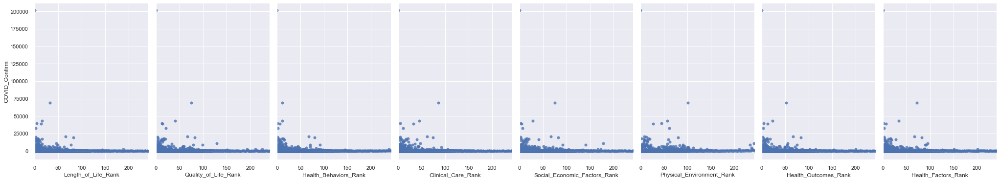

In [210]:
sns.pairplot(COVID_19_522_OVERALL_HEALTH, x_vars=['Length_of_Life_Rank','Quality_of_Life_Rank', 'Health_Behaviors_Rank', 'Clinical_Care_Rank', 'Social_Economic_Factors_Rank', 'Physical_Environment_Rank', 'Health_Outcomes_Rank', 'Health_Factors_Rank'],  y_vars='COVID_Confirm', height=5, aspect=0.7, kind='reg')

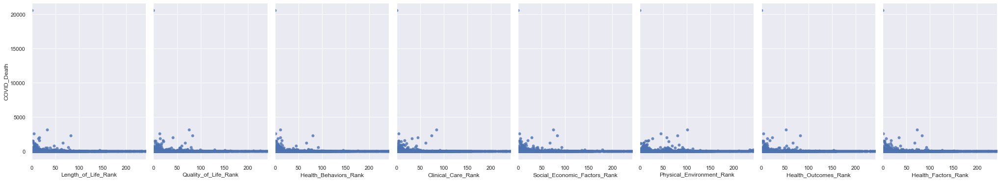

In [211]:
sns.pairplot(COVID_19_522_OVERALL_HEALTH, x_vars=['Length_of_Life_Rank','Quality_of_Life_Rank', 'Health_Behaviors_Rank', 'Clinical_Care_Rank', 'Social_Economic_Factors_Rank', 'Physical_Environment_Rank', 'Health_Outcomes_Rank', 'Health_Factors_Rank'],  y_vars='COVID_Death', height=5, aspect=0.7, kind='reg')

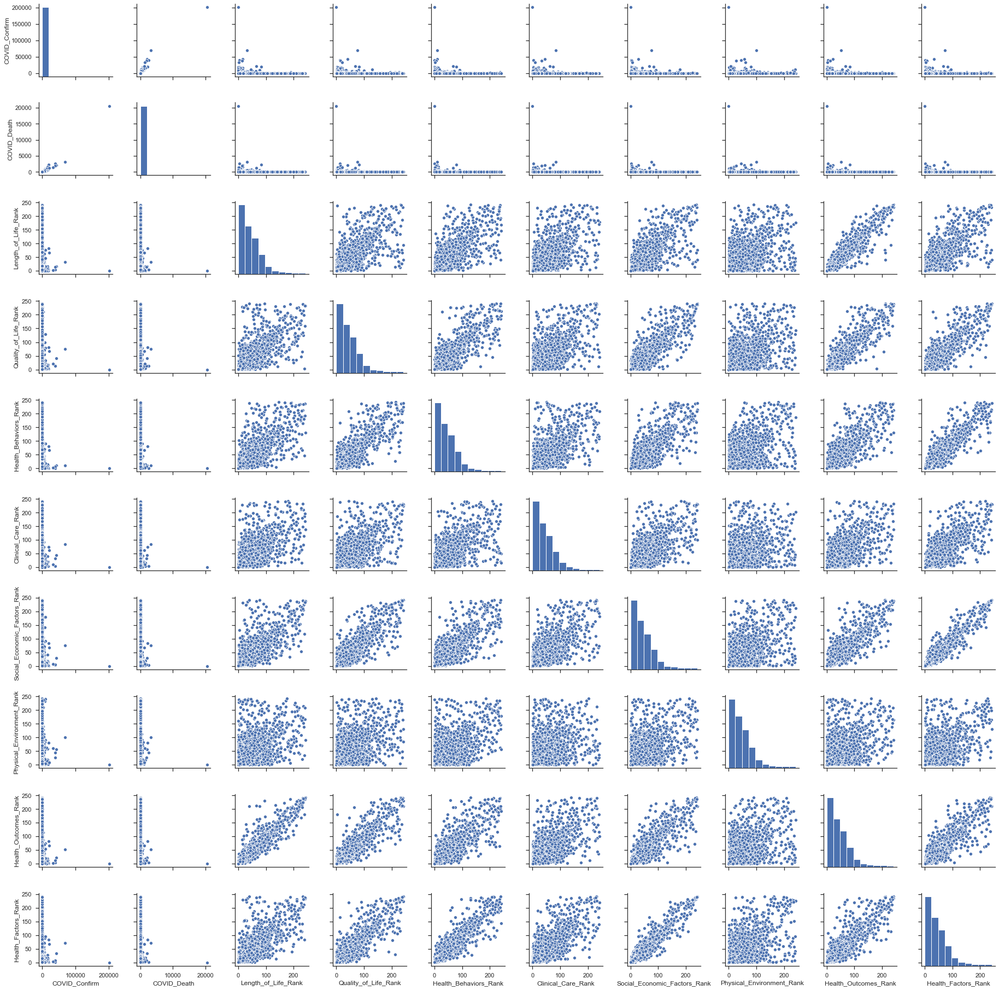

In [212]:
sns.set(style="ticks", color_codes=True)
pairp=g = sns.pairplot(COVID_19_522_OVERALL_HEALTH)
plt.show()


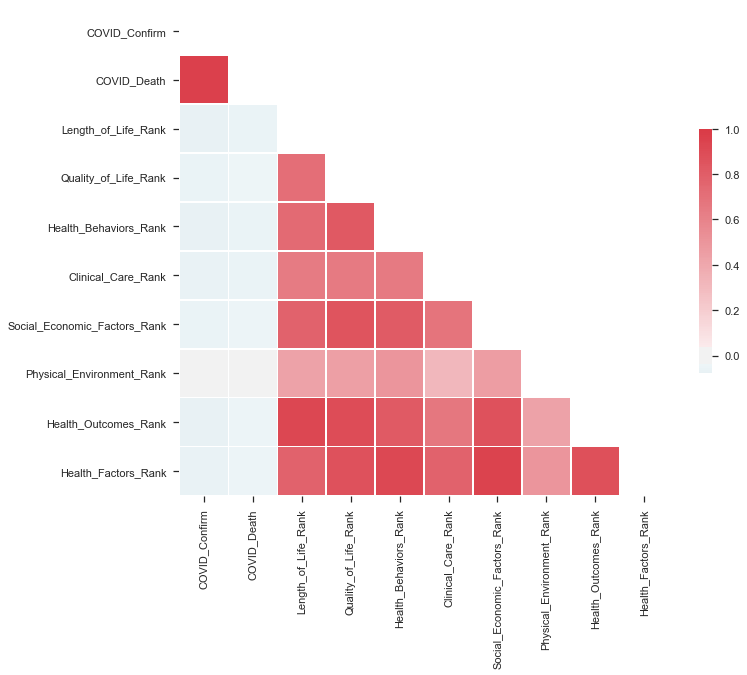

In [213]:
corr = COVID_19_522_OVERALL_HEALTH.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.show()


In [214]:
COVID_19_522_OVERALL_HEALTH.tail()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank
2927,WY,Wyoming,Sublette,3,0,2,4,5,9,8,17,2,7
2928,WY,Wyoming,Sweetwater,25,0,6,18,20,11,20,19,15,21
2929,WY,Wyoming,Teton,100,1,1,2,1,1,1,15,1,1
2930,WY,Wyoming,Uinta,13,0,18,21,19,6,17,13,21,17
2931,WY,Wyoming,Washakie,19,1,5,14,7,22,16,5,8,15


In [215]:
 COVID_19_522_OVERALL_HEALTH_POP = pandasql.sqldf("SELECT c.*, p.DensitySQMile FROM  COVID_19_522_OVERALL_HEALTH c JOIN MetropolitanPopulation p WHERE c.State_Name = c.State_Name AND c.County_Name = p.County_Name")

In [216]:
COVID_19_522_OVERALL_HEALTH_POP.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank,DensitySQMile
0,AL,Alabama,Autauga,149,3,18,5,12,15,3,51,11,8,91.8
1,AL,Alabama,Baldwin,271,9,4,4,3,7,8,14,3,3,114.6
2,AL,Alabama,Baldwin,271,9,4,4,3,7,8,14,3,3,177.3
3,AL,Alabama,Barbour,104,1,14,49,57,20,58,16,34,56,31.0
4,AL,Alabama,Barbour,104,1,14,49,57,20,58,16,34,56,48.6


In [217]:
COVID_19_522_DETAIL_HEALTH_POP = pandasql.sqldf("SELECT c.*, p.DensitySQMile FROM  COVID_19_522_DETAIL_HEALTH c JOIN MetropolitanPopulation p WHERE c.State_Name = c.State_Name AND c.County_Name = p.County_Name")

In [218]:
COVID_19_522_DETAIL_HEALTH_POP.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,...,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural,DensitySQMile
0,AL,Alabama,Autauga,149,3,827.0,450.0,532.0,111.0,445.0,...,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0,91.8
1,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,...,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3,114.6
2,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,...,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3,177.3
3,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,...,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8,31.0
4,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,...,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8,48.6


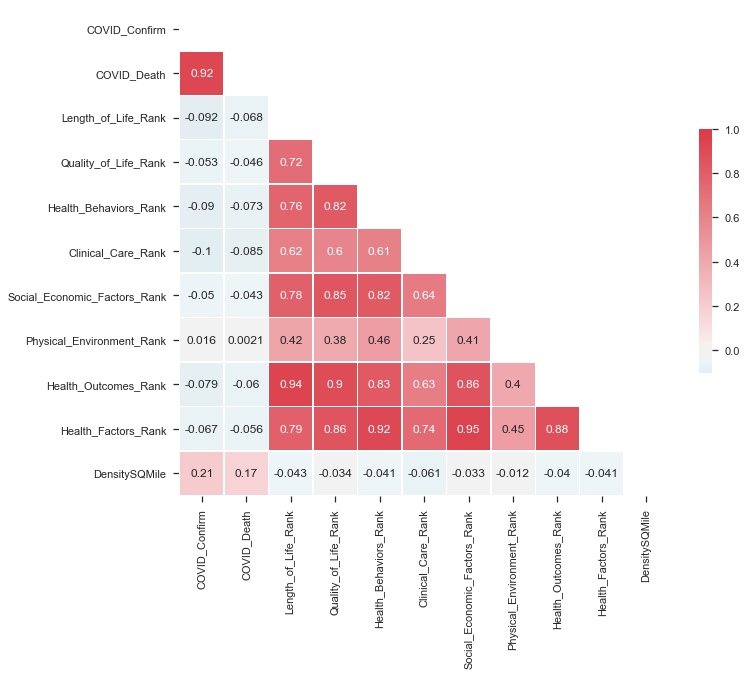

In [219]:
corr = COVID_19_522_OVERALL_HEALTH_POP.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
plt.show()


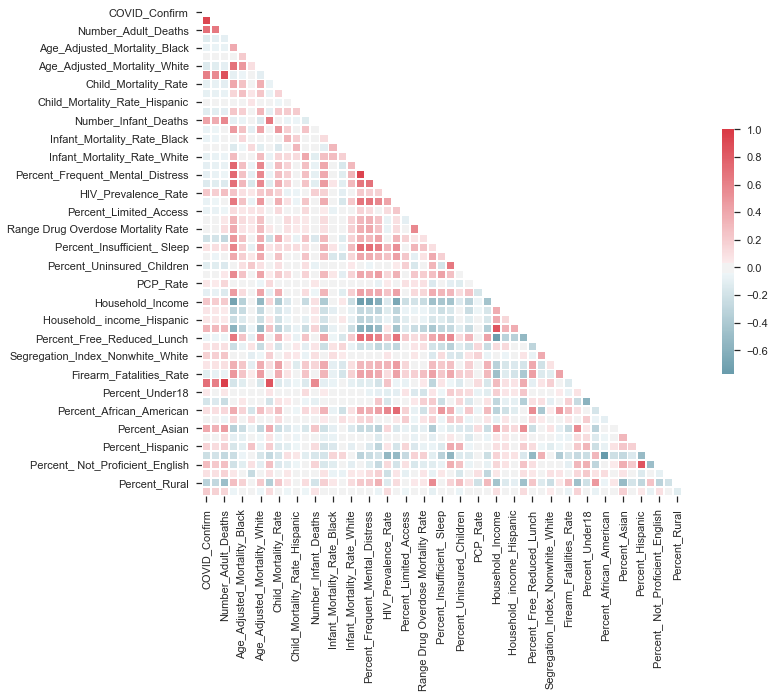

In [220]:
corr = COVID_19_522_DETAIL_HEALTH_POP.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.9, cbar_kws={"shrink": .5})
plt.show()


In [221]:
corr_matrix =  COVID_19_522_DETAIL_HEALTH_POP.corr().abs()

#the matrix is symmetric so we need to extract upper triangle matrix without diagonal (k = 1)
sol = (corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
                 .stack()
                 .sort_values(ascending=False))


In [222]:
#pd.set_option('display.max_rows', None)
dfsol = DataFrame(sol)
dfsol.to_csv("data/export.csv")

In [223]:
DETAIL_HEALTH_CORRELATION = LoadFile("data/DETAIL_HEALTH_CORRELATION.csv")

In [224]:
#pd.set_option('display.max_rows', None)
DETAIL_HEALTH_CORRELATION.head()

,COVID_19_22,DETAIL_HEALTH,CORRELATION
0,COVID_Confirm,Range Drug Overdose Mortality Rate,0.009556
1,COVID_Confirm,Heath_Care_Costs,0.021032
2,COVID_Confirm,Percent_American_Alaskan_Indian,0.022202
3,COVID_Confirm,Percent_Hawaiian_PacificIslander,0.026337
4,COVID_Confirm,Drug_Overdose_Mortality_Rate,0.028521


In [225]:
pandasql.sqldf("SELECT * FROM DETAIL_HEALTH_CORRELATION WHERE CORRELATION > 0.3")

,COVID_19_22,DETAIL_HEALTH,CORRELATION
0,COVID_Confirm,Percent_Rural,0.309034
1,COVID_Confirm,Household_ income_White,0.343365
2,COVID_Confirm,Percent_Asian,0.403223
3,COVID_Confirm,Number_Infant_Deaths,0.676308
4,COVID_Confirm,Number_Child_Deaths,0.678886
5,COVID_Confirm,Number_Adult_Deaths,0.705703
6,COVID_Confirm,Population,0.708302
7,COVID_Confirm,COVID_Death,0.924711
8,COVID_Death,Household_ income_White,0.303111
9,COVID_Death,Percent_Asian,0.347329


In [226]:
COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'] = np.round(np.log(COVID_19_522_OVERALL_HEALTH.COVID_Confirm),0)


In [227]:
COVID_19_522_DETAIL_HEALTH['Log_COVID_Confirm'] = np.round(np.log(COVID_19_522_DETAIL_HEALTH.COVID_Confirm),0)

In [228]:
COVID_19_522_OVERALL_HEALTH['Log_COVID_Death'] = np.round(np.log(COVID_19_522_OVERALL_HEALTH.COVID_Death),0)

In [229]:
COVID_19_522_DETAIL_HEALTH['Log_COVID_Death'] = np.round(np.log(COVID_19_522_DETAIL_HEALTH.COVID_Death),0)

In [230]:
COVID_19_522_OVERALL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank,Log_COVID_Confirm,Log_COVID_Death
0,AL,Alabama,Autauga,149,3,18,5,12,15,3,51,11,8,5.0,1.0
1,AL,Alabama,Baldwin,271,9,4,4,3,7,8,14,3,3,6.0,2.0
2,AL,Alabama,Barbour,104,1,14,49,57,20,58,16,34,56,5.0,0.0
3,AL,Alabama,Bibb,55,1,53,25,39,42,42,29,41,37,4.0,0.0
4,AL,Alabama,Blount,49,1,17,12,11,41,13,54,14,19,4.0,0.0


In [231]:
COVID_19_522_DETAIL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,...,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural,Log_COVID_Confirm,Log_COVID_Death
0,AL,Alabama,Autauga,149,3,827.0,450.0,532.0,111.0,445.0,...,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0,5.0,1.0
1,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,...,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3,6.0,2.0
2,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,...,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8,5.0,0.0
3,AL,Alabama,Bibb,55,1,408.0,529.0,630.0,111.0,527.0,...,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4,4.0,0.0
4,AL,Alabama,Blount,49,1,996.0,480.0,630.0,111.0,527.0,...,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0,4.0,0.0


In [232]:
%%capture
COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'] = COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'].fillna(0)

In [233]:
COVID_19_522_OVERALL_HEALTH.Log_COVID_Confirm.unique()

array([ 5.,  6.,  4.,  3.,  2.,  7.,  8.,  1.,  0.,  9., 11., 10., 12.])

In [234]:
pandasql.sqldf("SELECT * FROM COVID_19_522_OVERALL_HEALTH WHERE Log_COVID_Confirm < 0")

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank,Log_COVID_Confirm,Log_COVID_Death


In [235]:
COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'] = COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'].astype(np.int64)

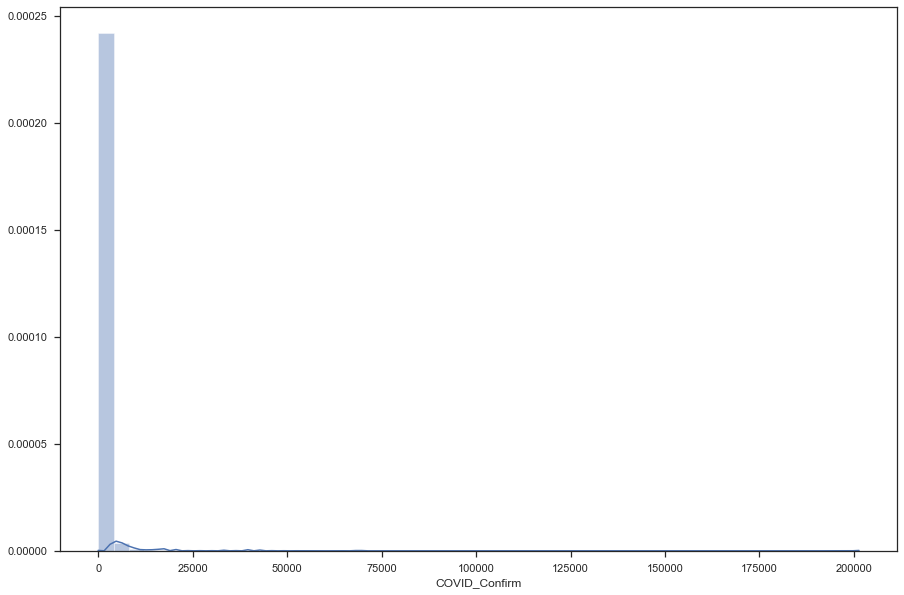

In [236]:
plt.figure(figsize=(15,10))
plt.tight_layout()
sns.distplot(COVID_19_522_OVERALL_HEALTH['COVID_Confirm'])


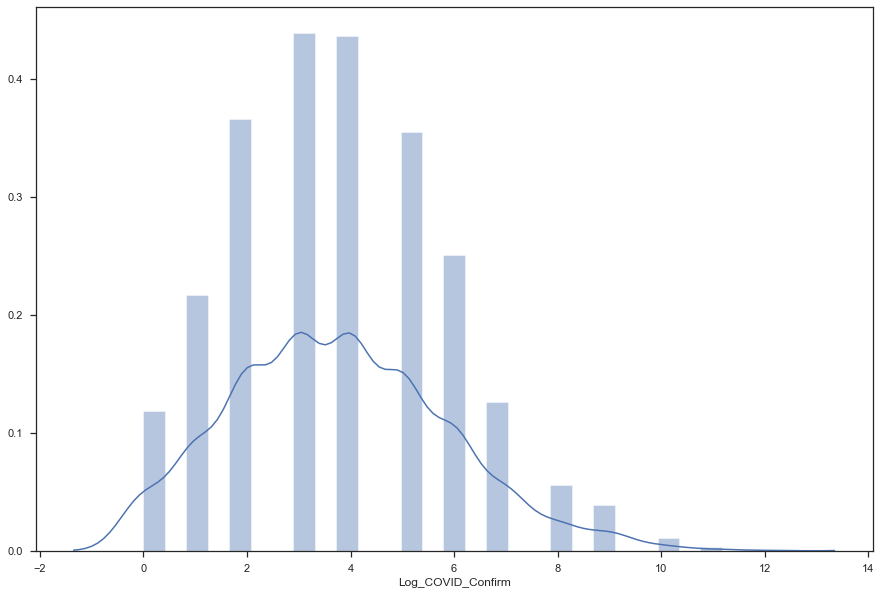

In [237]:
plt.figure(figsize=(15,10))
plt.tight_layout()
sns.distplot(COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'])


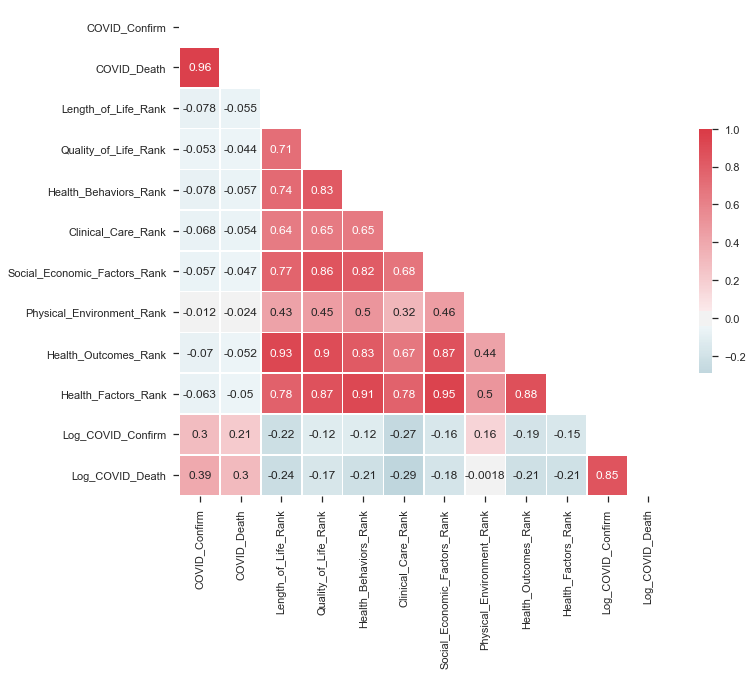

In [238]:
corr = COVID_19_522_OVERALL_HEALTH.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
plt.show()

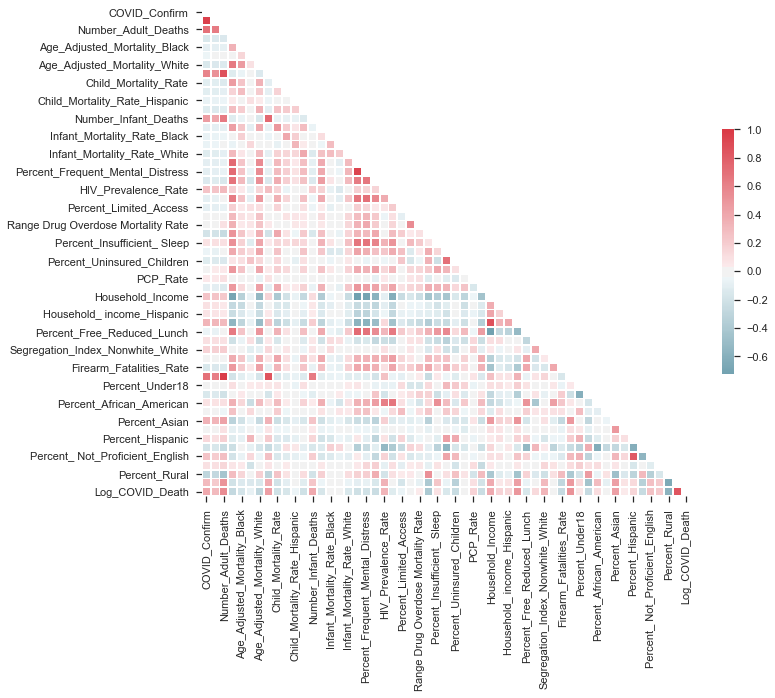

In [239]:

corr = COVID_19_522_DETAIL_HEALTH.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.9, cbar_kws={"shrink": .5})
plt.show()


In [240]:
dfcorr = DataFrame(corr).to_csv("data/DetailCorr.csv")

In [241]:
#print(corr["Log_COVID_Confirm"].sort_values(ascending=False))


In [242]:
#print(corr["Log_COVID_Death"].sort_values(ascending=False))

In [243]:
COVID_19_522_HEALTH_CORRELATION = pandasql.sqldf("SELECT c.State_Name, c.County_Name,c.COVID_Confirm, c.COVID_Death, c.Log_COVID_Death, c.Log_COVID_Confirm,  c.Percent_Rural,c.Percent_65_and_over,c.Percent_Disconnected_Youth,c.Percent_White,c.Percent_Uninsured_Children, c.Segregation_Index_Nonwhite_White, c.HIV_Prevalence_Rate, c.Household_Income, c.Percent_Asian,c.Population, c.[Household_ income_White] Household_income_White, p.DensitySQMile FROM COVID_19_522_DETAIL_HEALTH c LEFT JOIN MetropolitanPopulation p WHERE c.State_Name = p.State_Name AND c.County_Name = p.County_Name")

In [244]:
COVID_19_522_HEALTH_CORRELATION.dropna(inplace=True)

In [245]:
COVID_19_522_HEALTH_CORRELATION.isna().sum()

State_Name                          0
County_Name                         0
COVID_Confirm                       0
COVID_Death                         0
Log_COVID_Death                     0
Log_COVID_Confirm                   0
Percent_Rural                       0
Percent_65_and_over                 0
Percent_Disconnected_Youth          0
Percent_White                       0
Percent_Uninsured_Children          0
Segregation_Index_Nonwhite_White    0
HIV_Prevalence_Rate                 0
Household_Income                    0
Percent_Asian                       0
Population                          0
Household_income_White              0
DensitySQMile                       0
dtype: int64

In [246]:
COVID_19_522_HEALTH_CORRELATION.shape

(2809, 18)

In [247]:
COVID_19_522_HEALTH_CORRELATION.head()

,State_Name,County_Name,COVID_Confirm,COVID_Death,Log_COVID_Death,Log_COVID_Confirm,Percent_Rural,Percent_65_and_over,Percent_Disconnected_Youth,Percent_White,Percent_Uninsured_Children,Segregation_Index_Nonwhite_White,HIV_Prevalence_Rate,Household_Income,Percent_Asian,Population,Household_income_White,DensitySQMile
0,Alabama,Autauga,149,3,1.0,5.0,42.0,14.7,15.0,75.0,3.0,24.0,226.0,54487.0,1.1,55416.0,58556.0,91.8
1,Alabama,Baldwin,271,9,2.0,6.0,42.3,19.7,15.0,83.2,3.0,31.0,164.0,56460.0,1.1,208563.0,54184.0,114.6
2,Alabama,Barbour,104,1,0.0,5.0,67.8,18.0,31.0,46.5,4.0,22.0,436.0,32884.0,0.5,25965.0,46673.0,31.0
3,Alabama,Bibb,55,1,0.0,4.0,68.4,15.4,25.0,74.4,3.0,42.0,192.0,43079.0,0.2,22643.0,42020.0,36.8
4,Alabama,Blount,49,1,0.0,4.0,90.0,18.0,15.0,87.5,4.0,24.0,95.0,47213.0,0.3,57704.0,48045.0,88.9


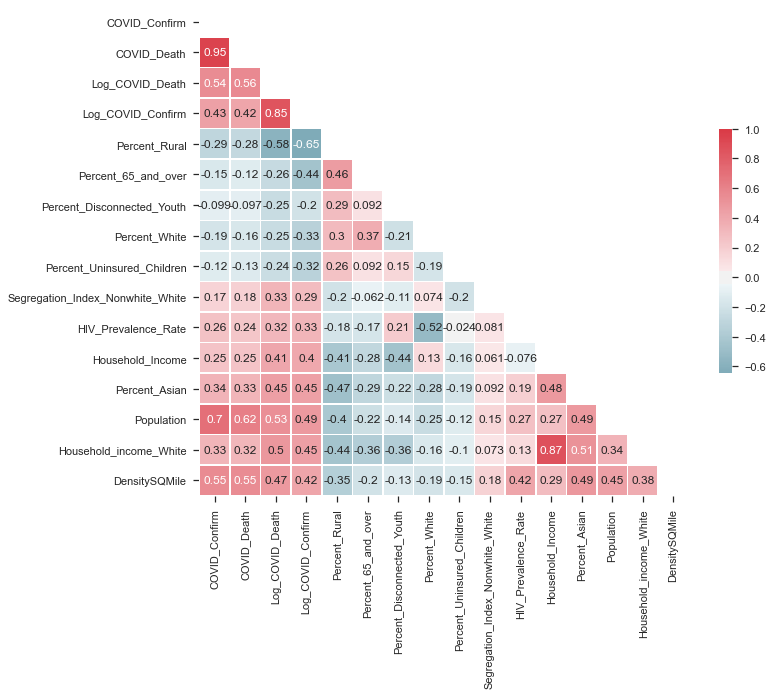

In [248]:
corr = COVID_19_522_HEALTH_CORRELATION.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

plt.savefig("plot/COVID_19_522_HEALTH_CORRELATION.png", bbox_inches = 'tight', dpi=400)
plt.show()

In [249]:
# Train and Test Models
# y_Log_COVID_Death
# y_Log_COVID_Confirm

In [250]:
# Calculate VIF Factors
# # For each X, calculate VIF and save in dataframe
# vif = pd.DataFrame()
# vif["VIF Factor"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
# vif["features"] = X.columns
# vif.round(1)
# #Imports
# import pandas as pd
# import numpy as np
# from patsy import dmatrices
# import statsmodels.api as sm
# from statsmodels.stats.outliers_influence import variance_inflation_factor
#https://chrisalbon.com/machine_learning/feature_selection/drop_highly_correlated_features/

In [251]:
# Create correlation matrix
corr_matrix = COVID_19_522_HEALTH_CORRELATION.corr().abs()

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# Find index of feature columns with correlation greater than 0.95
to_drop = [column for column in upper.columns if any(upper[column] > 0.3)]

In [252]:
COVID_19_522_HEALTH_CORRELATION.drop(COVID_19_522_HEALTH_CORRELATION[to_drop], axis=1)

,State_Name,County_Name,COVID_Confirm,Percent_Disconnected_Youth
0,Alabama,Autauga,149,15.0
1,Alabama,Baldwin,271,15.0
2,Alabama,Barbour,104,31.0
3,Alabama,Bibb,55,25.0
4,Alabama,Blount,49,15.0
...,...,...,...,...
2857,Wyoming,Sublette,3,14.0
2858,Wyoming,Sweetwater,25,10.0
2859,Wyoming,Teton,100,10.0
2860,Wyoming,Uinta,13,10.0


In [253]:
list(COVID_19_522_HEALTH_CORRELATION)

['State_Name',
 'County_Name',
 'COVID_Confirm',
 'COVID_Death',
 'Log_COVID_Death',
 'Log_COVID_Confirm',
 'Percent_Rural',
 'Percent_65_and_over',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Household_Income',
 'Percent_Asian',
 'Population',
 'Household_income_White',
 'DensitySQMile']

In [254]:
# Creating train and test dataset
train, test = train_test_split(COVID_19_522_HEALTH_CORRELATION, test_size =  .30)

In [255]:
y_train_confirm_column = ['Log_COVID_Confirm']
x_train_confirm_column = ['Percent_Rural',
 'Percent_65_and_over',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']

In [256]:
y_train_death_column = ['Log_COVID_Death']
x_train_death_column = ['Percent_Rural',
 'Percent_65_and_over',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']

In [257]:
# Setting up train and test data
# Setting up train and test data
y_train_confirm = DataFrame(train[y_train_confirm_column])
x_train_confirm = DataFrame(train[x_train_confirm_column])
y_test_confirm = DataFrame(test[y_train_confirm_column])
x_test_confirm = DataFrame(test[x_train_confirm_column])

In [258]:
# Setting up train and test data
y_train_death = DataFrame(train[y_train_death_column])
x_train_death = DataFrame(train[x_train_death_column])
y_test_death = DataFrame(test[y_train_death_column])
x_test_death = DataFrame(test[x_train_death_column])

# Models

In [259]:
from sklearn import linear_model
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from scipy.stats import uniform  # for training-and-test split
import statsmodels.api as sm  # statistical models (including regression)
import statsmodels.formula.api as smf  # R-like model specification
import matplotlib.pyplot as plt  # 2D plotting
import seaborn as sns  # PROVIDES TRELLIS AND SMALL MULTIPLE PLOTTING
sns.set(color_codes=True)
import random
random.seed(123)

## OLS 

In [260]:
ols_model_fit_confirm = sm.OLS(y_train_confirm, x_train_confirm).fit()
ols_model_fit_confirm.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:          COVID_Confirm   R-squared (uncentered):                   0.609
Model:                            OLS   Adj. R-squared (uncentered):              0.607
Method:                 Least Squares   F-statistic:                              253.9
Date:                Sun, 07 Jun 2020   Prob (F-statistic):                        0.00
Time:                        13:26:50   Log-Likelihood:                         -17026.
No. Observations:                1966   AIC:                                  3.408e+04
Df Residuals:                    1954   BIC:                                  3.414e+04
Df Model:                          12                                                  
Covariance Type:            nonrobust                                                  
====================================================================================================
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
Percent_Rural                        3.1952      1.442      2.216      0.027       0.367       6.024
Percent_65_and_over                 10.3392      8.375      1.235      0.217      -6.086      26.764
Percent_Disconnected_Youth          -1.7064      3.842     -0.444      0.657      -9.242       5.829
Percent_White                      -13.2342      2.382     -5.555      0.000     -17.906      -8.562
Percent_Uninsured_Children         -35.4865     10.287     -3.450      0.001     -55.661     -15.312
Segregation_Index_Nonwhite_White     6.4670      2.510      2.576      0.010       1.544      11.390
HIV_Prevalence_Rate                 -0.7913      0.250     -3.169      0.002      -1.281      -0.302
Household_Income                     0.0036      0.007      0.539      0.590      -0.009       0.017
Percent_Asian                     -113.5615     16.549     -6.862      0.000    -146.016     -81.107
Population                           0.0039      0.000     34.388      0.000       0.004       0.004
Household_income_White               0.0131      0.006      2.231      0.026       0.002       0.025
DensitySQMile                        1.0647      0.057     18.622      0.000       0.953       1.177
==============================================================================
Omnibus:                     2999.290   Durbin-Watson:                   1.976
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          2779759.699
Skew:                           8.918   Prob(JB):                         0.00
Kurtosis:                     186.346   Cond. No.                     1.87e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.87e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Text(0.5, 0.98, 'Actual vs predicted confirm')

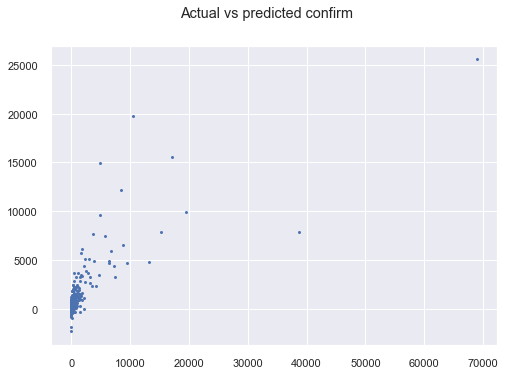

In [261]:
# Testing the confirm model
ols_model_pred_confirm = ols_model_fit_confirm.predict(x_test_confirm)
plt.plot(y_test_confirm, ols_model_pred_confirm, '.')
plt.suptitle('Actual vs predicted confirm')

In [262]:
ols_model_fit_death = sm.OLS(y_train_death, x_train_death).fit()
ols_model_fit_death.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:            COVID_Death   R-squared (uncentered):                   0.516
Model:                            OLS   Adj. R-squared (uncentered):              0.513
Method:                 Least Squares   F-statistic:                              173.3
Date:                Sun, 07 Jun 2020   Prob (F-statistic):                   8.63e-297
Time:                        13:26:51   Log-Likelihood:                         -11716.
No. Observations:                1966   AIC:                                  2.346e+04
Df Residuals:                    1954   BIC:                                  2.352e+04
Df Model:                          12                                                  
Covariance Type:            nonrobust                                                  
====================================================================================================
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
Percent_Rural                        0.1354      0.097      1.399      0.162      -0.054       0.325
Percent_65_and_over                  1.2338      0.562      2.195      0.028       0.131       2.336
Percent_Disconnected_Youth          -0.1077      0.258     -0.418      0.676      -0.613       0.398
Percent_White                       -0.8173      0.160     -5.112      0.000      -1.131      -0.504
Percent_Uninsured_Children          -2.5223      0.690     -3.653      0.000      -3.876      -1.168
Segregation_Index_Nonwhite_White     0.3978      0.168      2.361      0.018       0.067       0.728
HIV_Prevalence_Rate                 -0.0644      0.017     -3.842      0.000      -0.097      -0.032
Household_Income                     0.0002      0.000      0.420      0.675      -0.001       0.001
Percent_Asian                       -5.7856      1.111     -5.209      0.000      -7.964      -3.607
Population                           0.0002   7.52e-06     25.309      0.000       0.000       0.000
Household_income_White               0.0008      0.000      1.938      0.053   -8.98e-06       0.002
DensitySQMile                        0.0717      0.004     18.675      0.000       0.064       0.079
==============================================================================
Omnibus:                     2820.485   Durbin-Watson:                   2.001
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1934406.969
Skew:                           7.958   Prob(JB):                         0.00
Kurtosis:                     155.843   Cond. No.                     1.87e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.87e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Text(0.5, 0.98, 'Actual vs predicted death rate')

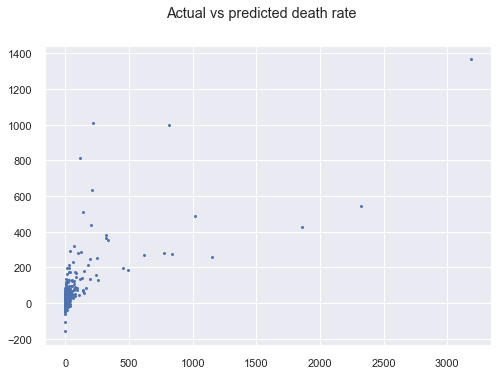

In [263]:
# Testing the death model
ols_model_pred_death = ols_model_fit_death.predict(x_test_death)
plt.plot(y_test_death, ols_model_pred_death, '.')
plt.suptitle('Actual vs predicted death rate')

## Linear Regression

In [264]:
# CONFIRM 

# Setting up variable for linear regression
reg_model = linear_model.LinearRegression()

# Train and test the modele
reg_model.fit(x_train_confirm, y_train_confirm)
y_pred_confirm = reg_model.predict(x_test_confirm)

In [265]:
#Model summary confirm 
print('coefficients: {}\nintercept: {}\nmean squared error: {}\nR-squared: {}'.format(
    reg_model.coef_,
    reg_model.intercept_,
    mean_squared_error(y_test_confirm, y_pred_confirm),
    r2_score(y_test_confirm, y_pred_confirm)
))

coefficients: [[ 3.12360450e+00  2.15875469e+01  4.22227963e+00 -9.09481727e+00
  -2.32848727e+01  8.71990668e+00 -5.35069169e-01  2.49337772e-03
  -1.07179139e+02  3.85842796e-03  2.06098951e-02  1.02377242e+00]]
intercept: [-1162.05875684]
mean squared error: 4263220.591130854
R-squared: 0.5521899121962497


Text(0.5, 0.98, 'Actual vs predicted confirm')

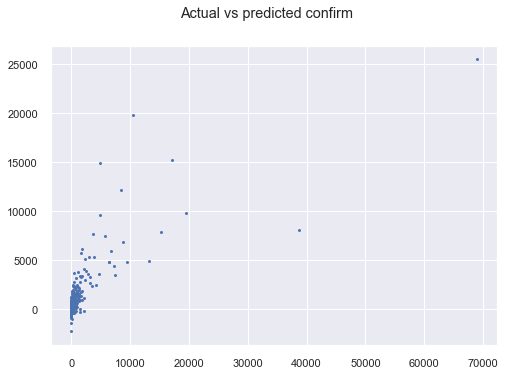

In [266]:
# Plotting actual and predicted values
plt.plot(y_test_confirm, y_pred_confirm, '.')
plt.suptitle('Actual vs predicted confirm')

In [267]:

# DEATH 

# Setting up variable for linear regression
reg_model = linear_model.LinearRegression()

# Train and test the modele
reg_model.fit(x_train_death, y_train_death)
y_pred_death = reg_model.predict(x_test_death)

In [268]:
#Model summary confirm 
print('coefficients: {}\nintercept: {}\nmean squared error: {}\nR-squared: {}'.format(
    reg_model.coef_,
    reg_model.intercept_,
    mean_squared_error(y_test_death, y_pred_death),
    r2_score(y_test_death, y_pred_death)
))

coefficients: [[ 1.29636434e-01  2.14080286e+00  3.70310841e-01 -4.83559758e-01
  -1.53851487e+00  5.79483254e-01 -4.37393966e-02  9.89316938e-05
  -5.27096991e+00  1.90812572e-04  1.36841961e-03  6.83647705e-02]]
intercept: [-93.6985209]
mean squared error: 15391.339369065274
R-squared: 0.4750413444881729


Text(0.5, 0.98, 'Actual vs predicted death')

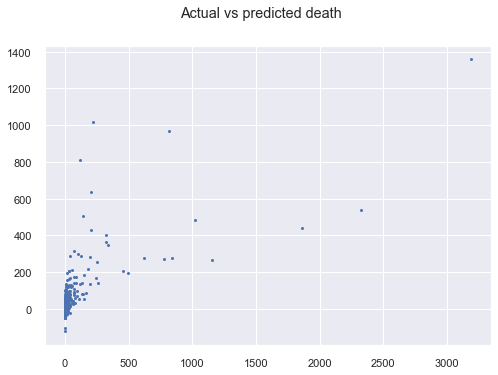

In [269]:
# Plotting actual and predicted values
plt.plot(y_test_death, y_pred_death, '.')
plt.suptitle('Actual vs predicted death')

In [270]:
#us_counties_cases_deaths.head()

## decision Tree

In [271]:
dt = DecisionTreeClassifier(random_state=42, max_depth=3)
dt.fit(x_train_death, y_train_death)



DecisionTreeClassifier(max_depth=3, random_state=42)

In [272]:
from lime import lime_tabular
explainer = lime_tabular.LimeTabularExplainer(x_train_death.values,feature_names=x_train_death_column,)
exp = explainer.explain_instance(x_train_death.iloc[-1].values, dt.predict_proba)



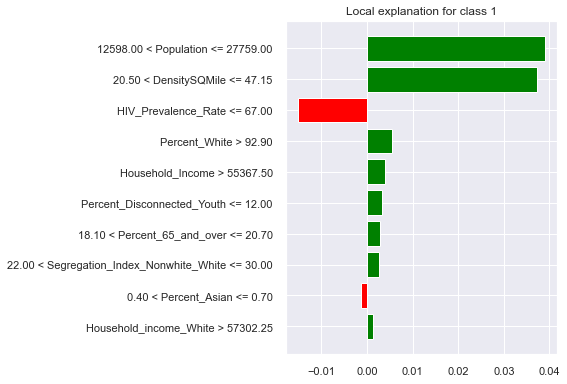

In [273]:
fig = exp.as_pyplot_figure()
fig.tight_layout()
#fig.savefig("plot/mlpr_1301.png")



#### Features for the sample push the prediction toward the right (death) or left (not dead).



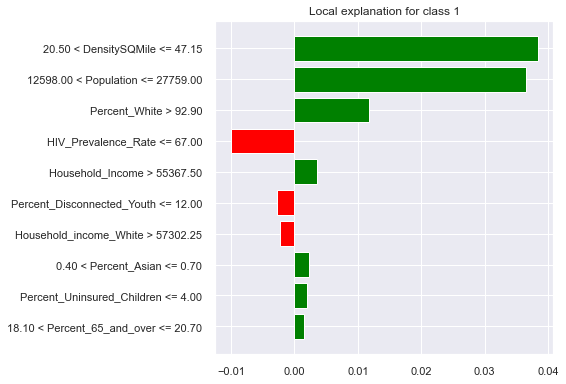

In [274]:
from lime import lime_tabular
explainer = lime_tabular.LimeTabularExplainer(x_train_confirm.values,feature_names=x_train_confirm_column,)
exp = explainer.explain_instance(x_train_confirm.iloc[-1].values, dt.predict_proba)
fig = exp.as_pyplot_figure()
fig.tight_layout()


# More models

In [316]:
confirm_case= COVID_19_522_HEALTH_CORRELATION [['Log_COVID_Confirm','Percent_Rural',
 'Percent_65_and_over',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']]

In [321]:
confirm_death= COVID_19_522_HEALTH_CORRELATION[['Log_COVID_Death','Percent_Rural',
 'Percent_65_and_over',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']]

TypeError: list indices must be integers or slices, not list

In [278]:
from sklearn import (ensemble,preprocessing,tree,model_selection,)
from sklearn.metrics import (auc,confusion_matrix,roc_auc_score,roc_curve,)
from sklearn.model_selection import (train_test_split,StratifiedKFold,)
from yellowbrick.classifier import (ConfusionMatrix,ROCAUC,)
from yellowbrick.model_selection import (LearningCurve,)
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

In [279]:
#scaler = StandardScaler()

In [288]:
scalerFit=scaler.fit(confirm_case)

StandardScaler()

In [281]:
#scaled_features = scaler.transform(confirm_case)

In [282]:
#DataFrame(scaled_features).head()

In [283]:
# plt.figure(figsize=(15,10))
# plt.tight_layout()
# sns.distplot(scaled_features['Log_COVID_Confirm'])


In [284]:
# df_confirm = pd.DataFrame(scaled_features,columns=confirm_case.columns[1:])
# df_confirm.head()

In [293]:
# TRAIN TEST SPLIT
X_train, X_test, y_train, y_test = train_test_split(confirm_case,confirm_case['COVID_Confirm'],test_size=0.80)


In [ ]:
## Feature importance

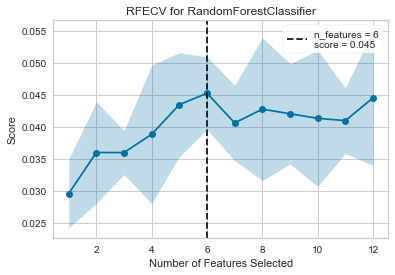

In [435]:
from yellowbrick.features import RFECV
fig, ax = plt.subplots(figsize=(6, 4))
rfe = RFECV(
    ensemble.RandomForestClassifier(
        n_estimators=100
    ),
    cv=5,
)
rfe.fit(X, y)
rfe.rfe_estimator_.ranking_
rfe.rfe_estimator_.n_features_
rfe.rfe_estimator_.support_
rfe.poof()
# fig.savefig("plot/mlpr_0803.png", dpi=300)

In [436]:
from sklearn.feature_selection import RFE
model = ensemble.RandomForestClassifier(
    n_estimators=100
)
rfe = RFE(model, 4)
rfe.fit(X, y)
X.columns[rfe.support_]

Index(['Percent_White', 'Population', 'Household_income_White',
       'DensitySQMile'],
      dtype='object')

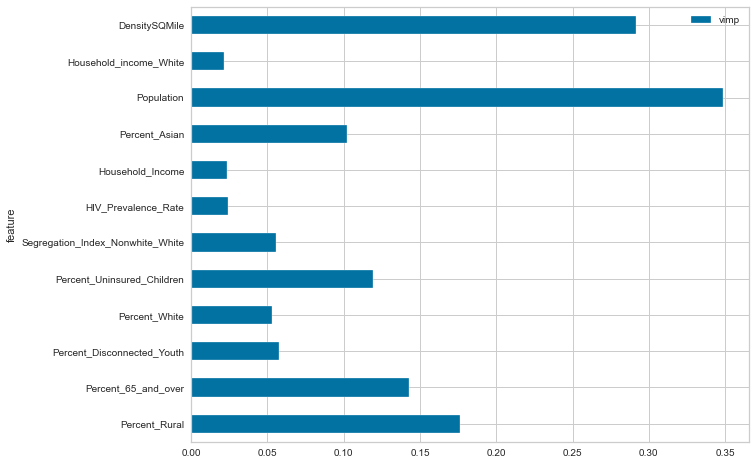

In [437]:
from sklearn import feature_selection
mic = feature_selection.mutual_info_classif(
    X, y
)
fig, ax = plt.subplots(figsize=(10, 8))
(
    pd.DataFrame(
        {"feature": X.columns, "vimp": mic}
    )
    .set_index("feature")
    .plot.barh(ax=ax)
)
# fig.savefig("plot/mlpr_0804.png")

#  KNN

In [294]:
from sklearn.neighbors import KNeighborsClassifier

In [295]:
knn = KNeighborsClassifier(n_neighbors=1)

In [296]:
knn.fit(X_train,y_train)

KNeighborsClassifier(n_neighbors=1)

In [297]:
# PREDICTIONS AND EVALUATIONS
pred = knn.predict(X_test)

In [298]:
from sklearn.metrics import classification_report,confusion_matrix

In [299]:
print(classification_report(y_test,pred))

   0.00         5
          68       0.00      0.00      0.00         2
          69       0.00      0.00      0.00         1
          71       0.00      0.00      0.00         1
          73       0.33      0.17      0.22         6
          74       0.00      0.00      0.00         1
          75       0.00      0.00      0.00         1
          76       0.00      0.00      0.00         3
          77       0.00      0.00      0.00         0
          78       0.00      0.00      0.00         1
          79       0.00      0.00      0.00         2
          80       0.00      0.00      0.00         1
          81       0.00      0.00      0.00         2
          82       0.00      0.00      0.00         2
          83       0.00      0.00      0.00         4
          84       0.00      0.00      0.00         1
          85       0.00      0.00      0.00         1
          86       0.00      0.00      0.00         1
          87       0.00      0.00      0.00         0
          

In [300]:
# CHOOSING k VALUE

error_rate = []

# Will take some time
for i in range(1,200):
    
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train,y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

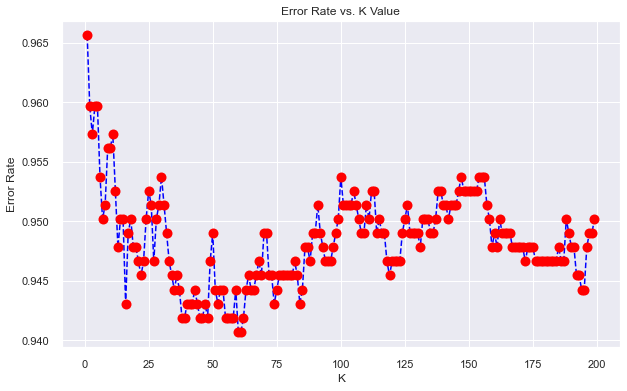

In [301]:
plt.figure(figsize=(10,6))
plt.plot(range(1,200),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

In [302]:
# NOW WITH K=
knn = KNeighborsClassifier(n_neighbors=80)

knn.fit(X_train,y_train)
pred = knn.predict(X_test)

print('WITH K=220')
print('\n')
print(confusion_matrix(y_test,pred))
print('\n')
print(classification_report(y_test,pred))

WITH K=220


[[28  6  5 ...  0  0  0]
 [21  2  1 ...  0  0  0]
 [13  1  4 ...  0  0  0]
 ...
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]]


              precision    recall  f1-score   support

           1       0.20      0.68      0.31        41
           2       0.03      0.07      0.04        30
           3       0.07      0.19      0.10        21
           4       0.00      0.00      0.00        21
           5       0.06      0.04      0.05        25
           6       0.02      0.06      0.03        18
           7       0.05      0.04      0.04        25
           8       0.17      0.04      0.06        26
           9       0.00      0.00      0.00        14
          10       0.04      0.13      0.06        15
          11       0.00      0.00      0.00        13
          12       0.08      0.07      0.07        14
          13       0.00      0.00      0.00        15
          14       0.00      0.00      0.00         1
          15      

# SVM

In [303]:
# PIP INSTALL JANITOR
import janitor as jn
# import configparser

X, y = jn.get_features_targets(confirm_case, target_columns='COVID_Confirm')  

In [304]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30)

In [305]:
from sklearn.svm import SVC

In [306]:
svc_model = SVC()

In [307]:
svc_model.fit(X_train,y_train)

SVC()

In [308]:
# MODEL EVALUATION
predictions = svc_model.predict(X_test)



In [309]:
from sklearn.metrics import classification_report,confusion_matrix

In [310]:
print(confusion_matrix(y_test,predictions))

[[45  0  0 ...  0  0  0]
 [35  0  0 ...  0  0  0]
 [21  0  0 ...  0  0  0]
 ...
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]
 [ 1  0  0 ...  0  0  0]]


In [311]:
print(classification_report(y_test,predictions))

precision    recall  f1-score   support

           1       0.06      1.00      0.12        45
           2       0.00      0.00      0.00        35
           3       0.00      0.00      0.00        21
           4       0.00      0.00      0.00        17
           5       0.00      0.00      0.00        22
           6       0.00      0.00      0.00        14
           7       0.00      0.00      0.00        20
           8       0.00      0.00      0.00        16
           9       0.00      0.00      0.00        11
          10       0.00      0.00      0.00        17
          11       0.00      0.00      0.00        13
          12       0.00      0.00      0.00        10
          13       0.00      0.00      0.00        14
          14       0.00      0.00      0.00        10
          15       0.00      0.00      0.00        10
          16       0.00      0.00      0.00        10
          17       0.00      0.00      0.00         8
          18       0.00      0.00      0.

In [312]:
# GridSearch

In [313]:
from sklearn.model_selection import GridSearchCV

In [314]:
param_grid = {'C': [0.1,1, 10, 100], 'gamma': [1,0.1,0.01,0.001]} 

In [315]:
grid = GridSearchCV(SVC(),param_grid,refit=True,verbose=2)
grid.fit(X_train,y_train)

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV] C=0.1, gamma=1 ..................................................
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[CV] ................................... C=0.1, gamma=1, total=   5.3s
[CV] C=0.1, gamma=1 ..................................................
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.2s remaining:    0.0s
[CV] ................................... C=0.1, gamma=1, total=   5.9s
[CV] C=0.1, gamma=1 ..................................................
[CV] ................................... C=0.1, gamma=1, total=   5.6s
[CV] C=0.1, gamma=1 ..................................................
[CV] ................................... C=0.1, gamma=1, total=   5.6s
[CV] C=0.1, gamma=1 ..................................................
[CV] ................................... C=0.1, gamma=1, total=   5.5s
[CV] C=0.1, gamma=0.1 ..............................................

KeyboardInterrupt: 

In [418]:
grid_predictions = grid.predict(X_test)

In [419]:
print(confusion_matrix(y_test,grid_predictions))

[[43  0  0 ...  0  0  0]
 [16  0  0 ...  0  0  0]
 [29  0  0 ...  0  0  0]
 ...
 [ 1  0  0 ...  0  0  0]
 [ 1  0  0 ...  0  0  0]
 [ 1  0  0 ...  0  0  0]]


In [420]:
print(classification_report(y_test,grid_predictions))

precision    recall  f1-score   support

           1       0.05      1.00      0.10        43
           2       0.00      0.00      0.00        16
           3       0.00      0.00      0.00        29
           4       0.00      0.00      0.00        26
           5       0.00      0.00      0.00        24
           6       0.00      0.00      0.00        15
           7       0.00      0.00      0.00        28
           8       0.00      0.00      0.00        20
           9       0.00      0.00      0.00        12
          10       0.00      0.00      0.00        17
          11       0.00      0.00      0.00        13
          12       0.00      0.00      0.00        14
          13       0.00      0.00      0.00        13
          14       0.00      0.00      0.00         5
          15       0.00      0.00      0.00        10
          16       0.00      0.00      0.00         9
          17       0.00      0.00      0.00         8
          18       0.00      0.00      0.

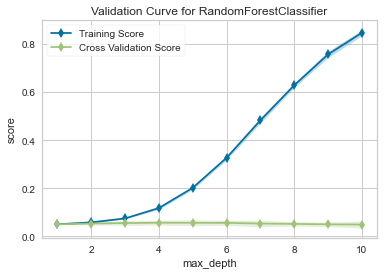

In [421]:
from yellowbrick.model_selection import (ValidationCurve,)
fig, ax = plt.subplots(figsize=(6, 4))
vc_viz = ValidationCurve(

RandomForestClassifier(n_estimators=100),
param_name="max_depth",
param_range=np.arange(1, 11),cv=10,n_jobs=-1,)

vc_viz.fit(X, y)
vc_viz.poof()
#fig.savefig("plot/mlpr_1101.png", dpi=300)




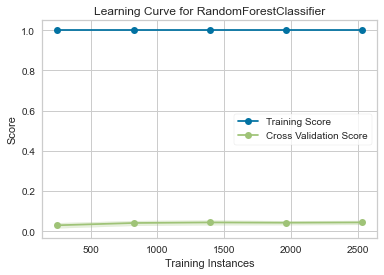

In [422]:
from yellowbrick.model_selection import (LearningCurve,)

fig, ax = plt.subplots(figsize=(6, 4))
lc3_viz = LearningCurve(RandomForestClassifier(n_estimators=100), cv=10,)

lc3_viz.fit(X, y)
lc3_viz.poof()
#fig.savefig("plot/mlpr_1102.png", dpi=300)

